In [1]:
import geopandas as gpd
import folium
import matplotlib.pyplot as plt

In [2]:
nyc_streets = gpd.read_file("../data/NYC Street Centerline (CSCL).geojson")

In [3]:
nyc_streets.shape

(120000, 32)

In [14]:
nyc_streets.dtypes

rw_type         object
l_low_hn        object
pre_direct      object
st_width        object
r_zip           object
r_low_hn        object
bike_lane       object
post_type       object
r_blkfc_id      object
bike_trafd      object
frm_lvl_co      object
post_modif      object
pre_type        object
full_stree      object
l_blkfc_id      object
shape_leng      object
to_lvl_co       object
modified        object
status          object
post_direc      object
r_high_hn       object
l_zip           object
snow_pri        object
borocode        object
trafdir         object
pre_modifi      object
st_label        object
physicalid      object
st_name         object
created         object
l_high_hn       object
geometry      geometry
dtype: object

In [5]:
nyc_streets.head()

,rw_type,l_low_hn,pre_direct,st_width,r_zip,r_low_hn,bike_lane,post_type,r_blkfc_id,bike_trafd,...,snow_pri,borocode,trafdir,pre_modifi,st_label,physicalid,st_name,created,l_high_hn,geometry
0,6,None,None,0,10458,None,None,TRL,0,None,...,None,2,NV,None,MITSUBISHI WILD WETLAND TRL,164809,MITSUBISHI WILD WETLAND,2014-08-19T00:00:00+00:00,None,"MULTILINESTRING ((-73.87862 40.86192, -73.8786..."
1,1,215-001,None,35,11360,215-000,None,AVE,112262650,None,...,S,4,TW,None,28 AVE,6110,28,2007-11-29T00:00:00+00:00,215-027,"MULTILINESTRING ((-73.77290 40.77780, -73.7720..."
2,1,5631,None,42,10471,5602,None,AVE,1522601877,None,...,H,2,TW,None,ARLINGTON AVE,61140,ARLINGTON,2007-11-29T00:00:00+00:00,5699,"MULTILINESTRING ((-73.90711 40.90519, -73.9067..."
3,1,317,None,50,11217,316,2,ST,1922612977,TW,...,C,3,TW,None,SCHERMERHORN ST,145494,SCHERMERHORN,2007-11-29T00:00:00+00:00,399,"MULTILINESTRING ((-73.98182 40.68733, -73.9805..."
4,1,120-011,None,40,11415,0,None,BLVD,92269521,None,...,C,4,TF,None,QUEENS BLVD,12438,QUEENS,2007-11-29T00:00:00+00:00,120-011,"MULTILINESTRING ((-73.83002 40.71401, -73.8298..."


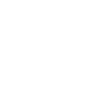

In [6]:
nyc_streets.loc[0,"geometry"]

In [23]:
nyc_streets.loc[0,"shape_leng"]

'1026.07752317'

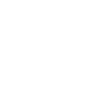

In [7]:
nyc_streets.loc[500,"geometry"]

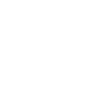

In [8]:
nyc_streets.loc[1500,"geometry"]

In [19]:
latitude = 40.677834
longitude = -74.012443
map_nyc = folium.Map(location=[latitude, longitude], zoom_start=10)

In [22]:
map_nyc

In [21]:
small_streets = nyc_streets.loc[0:1000]
#small_streets = nyc_streets[nyc_streets.borocode == '1']
folium.GeoJson(small_streets, name="geojson").add_to(map_nyc)

In [18]:
map_nyc

## Convert GPD to Graph

In [36]:
import osmnx as ox
import momepy
import networkx as nx
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd

In [37]:
place_name = "New-York, USA"
graph = ox.graph_from_place(place_name, network_type='drive')

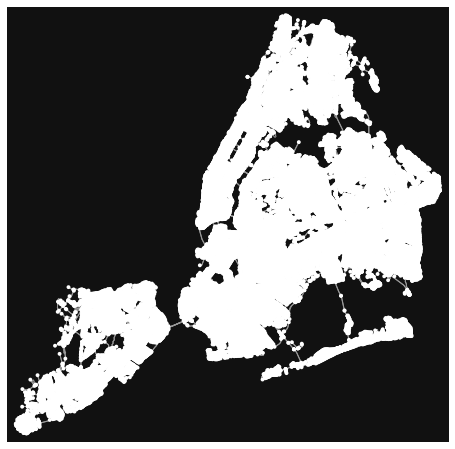

In [40]:
fig, ax = ox.plot_graph(graph)

In [41]:

# Retrieve only edges from the graph
edges = ox.graph_to_gdfs(graph, nodes=False, edges=True)

In [44]:
edges.shape

(140812, 15)

In [46]:
edges.head()

osmid  oneway  \
u        v         key                                            
39076461 42854803  0                           25161578    True   
         274283981 0              [122633397, 25161349]    True   
39076490 277672046 0                            5699971    True   
         277672005 0                           39084898    True   
39076504 462124701 0    [618709517, 618709515, 5700693]    True   

                              highway   length  \
u        v         key                           
39076461 42854803  0    motorway_link  254.709   
         274283981 0         motorway  767.800   
39076490 277672046 0    motorway_link  259.674   
         277672005 0         motorway  291.839   
39076504 462124701 0    motorway_link  433.148   

                                                                 geometry  \
u        v         key                                                      
39076461 42854803  0    LINESTRING (-73.79463 40.78641, -73.79361 40.7...   
         274283981 0    LINESTRING (-73.79463 40.78641, -73.79309 40.7...   
39076490 277672046 0    LINESTRING (-73.75709 40.76243, -73.75721 40.7...   
         277672005 0    LINESTRING (-73.75709 40.76243, -73.75741 40.7...   
39076504 462124701 0    LINESTRING (-73.74416 40.75347, -73.74453 40.7...   

                       lanes  ref                  name maxspeed bridge  \
u        v         key                                                    
39076461 42854803  0     NaN  NaN                   NaN      NaN    NaN   
         274283981 0       2  CIP  Cross Island Parkway   50 mph    NaN   
39076490 277672046 0     NaN  NaN                   NaN      NaN    NaN   
         277672005 0       3  CIP  Cross Island Parkway   50 mph    NaN   
39076504 462124701 0       1  NaN                   NaN      NaN    yes   

                       access tunnel width junction service  
u        v         key                                       
39076461 42854803  0      NaN    NaN   NaN      NaN     NaN  
         274283981 0      NaN    NaN   NaN      NaN     NaN  
39076490 277672046 0      NaN    NaN   NaN      NaN     NaN  
         277672005 0      NaN    NaN   NaN      NaN     NaN  
39076504 462124701 0      NaN    NaN   NaN      NaN     NaN

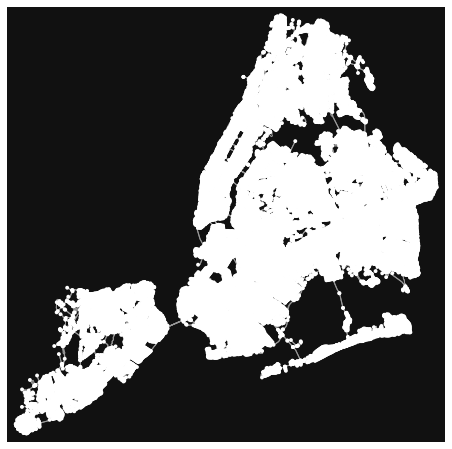

In [45]:
graph_proj = ox.project_graph(graph)
fig, ax = ox.plot_graph(graph_proj)

In [49]:
# Get Edges and Nodes
nodes_proj, edges_proj = ox.graph_to_gdfs(graph_proj, nodes=True, edges=True)

In [50]:
nodes_proj.shape

(55361, 8)

In [52]:
nodes_proj.head()

,y,x,ref,highway,street_count,lon,lat,geometry
osmid,,,,,,,,
39076461,4.515746e+06,601701.349944,33,motorway_junction,3,-73.794627,40.786409,POINT (601701.350 4515745.790)
42854803,4.515832e+06,601927.713294,NaN,traffic_signals,3,-73.791931,40.787159,POINT (601927.713 4515832.111)
274283981,4.516077e+06,602389.141841,NaN,NaN,3,-73.786423,40.789305,POINT (602389.142 4516076.742)
39076490,4.513128e+06,604906.239252,31W,motorway_junction,3,-73.757091,40.762429,POINT (604906.239 4513128.015)
277672046,4.513122e+06,604936.844109,NaN,NaN,3,-73.756729,40.762371,POINT (604936.844 4513121.942)


In [53]:
edges_proj.shape

(140812, 15)

In [54]:
edges_proj.head()

osmid  oneway  \
u         v          key                                                      
39076461  42854803   0                                     25161578    True   
          274283981  0                        [122633397, 25161349]    True   
42854803  42847609   0                                     25161438   False   
          42816655   0                                     25161438   False   
274283981 3789687872 0    [39084897, 40944009, 420749860, 40944010]    True   

                                highway   length  \
u         v          key                           
39076461  42854803   0    motorway_link  254.709   
          274283981  0         motorway  767.800   
42854803  42847609   0         tertiary  143.257   
          42816655   0         tertiary  140.936   
274283981 3789687872 0         motorway  675.211   

                                                                   geometry  \
u         v          key                                                      
39076461  42854803   0    LINESTRING (601701.350 4515745.790, 601786.542...   
          274283981  0    LINESTRING (601701.350 4515745.790, 601830.457...   
42854803  42847609   0    LINESTRING (601927.713 4515832.111, 601964.997...   
          42816655   0    LINESTRING (601927.713 4515832.111, 601884.503...   
274283981 3789687872 0    LINESTRING (602389.142 4516076.742, 602424.852...   

                         lanes  ref                  name maxspeed bridge  \
u         v          key                                                    
39076461  42854803   0     NaN  NaN                   NaN      NaN    NaN   
          274283981  0       2  CIP  Cross Island Parkway   50 mph    NaN   
42854803  42847609   0     NaN  NaN  Cross Island Parkway      NaN    NaN   
          42816655   0     NaN  NaN  Cross Island Parkway      NaN    NaN   
274283981 3789687872 0       3  CIP  Cross Island Parkway   50 mph    yes   

                         access junction tunnel width service  
u         v          key                                       
39076461  42854803   0      NaN      NaN    NaN   NaN     NaN  
          274283981  0      NaN      NaN    NaN   NaN     NaN  
42854803  42847609   0      NaN      NaN    NaN   NaN     NaN  
          42816655   0      NaN      NaN    NaN   NaN     NaN  
274283981 3789687872 0      NaN      NaN    NaN   NaN     NaN

In [55]:
streets = gpd.read_file(momepy.datasets.get_path('bubenec'), layer='streets')

streets.head()


/Users/jeromecoumont/opt/anaconda3/lib/python3.8/site-packages/geopandas/geodataframe.py:422: RuntimeWarning: Sequential read of iterator was interrupted. Resetting iterator. This can negatively impact the performance.
  for feature in features_lst:


,geometry
0,"LINESTRING (1603585.640 6464428.774, 1603413.2..."
1,"LINESTRING (1603268.502 6464060.781, 1603296.8..."
2,"LINESTRING (1603607.303 6464181.853, 1603592.8..."
3,"LINESTRING (1603678.970 6464477.215, 1603675.6..."
4,"LINESTRING (1603537.194 6464558.112, 1603557.6..."


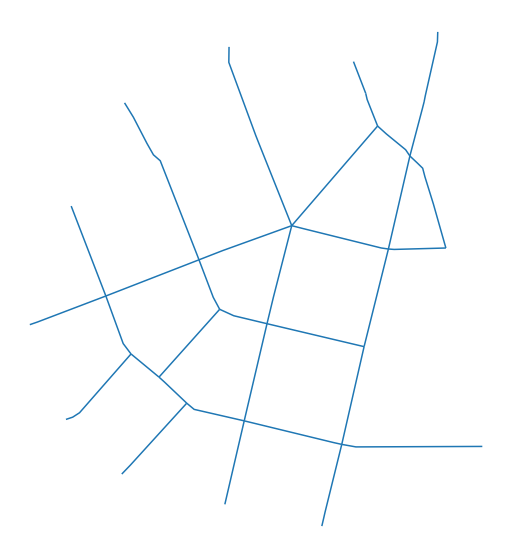

In [56]:

f, ax = plt.subplots(figsize=(10, 10))
streets.plot(ax=ax)
ax.set_axis_off()
plt.show()

In [31]:
nyc_graph = momepy.gdf_to_nx(nyc_streets, approach='primal')

/Users/jeromecoumont/opt/anaconda3/lib/python3.8/site-packages/momepy/utils.py:234: UserWarning: Geometry is in a geographic CRS. Results from 'length' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_network[length] = gdf_network.geometry.length


NotImplementedError: Multi-part geometries do not provide a coordinate sequence

In [70]:
nyc_streets_exploded = small_streets.explode()

In [71]:
nyc_streets_exploded.shape

(1001, 32)

In [72]:
nyc_streets_exploded.head()

,,rw_type,l_low_hn,pre_direct,st_width,r_zip,r_low_hn,bike_lane,post_type,r_blkfc_id,bike_trafd,...,snow_pri,borocode,trafdir,pre_modifi,st_label,physicalid,st_name,created,l_high_hn,geometry
0,0,6,None,None,0,10458,None,None,TRL,0,None,...,None,2,NV,None,MITSUBISHI WILD WETLAND TRL,164809,MITSUBISHI WILD WETLAND,2014-08-19T00:00:00+00:00,None,"LINESTRING (-73.87862 40.86192, -73.87861 40.8..."
1,0,1,215-001,None,35,11360,215-000,None,AVE,112262650,None,...,S,4,TW,None,28 AVE,6110,28,2007-11-29T00:00:00+00:00,215-027,"LINESTRING (-73.77290 40.77780, -73.77204 40.7..."
2,0,1,5631,None,42,10471,5602,None,AVE,1522601877,None,...,H,2,TW,None,ARLINGTON AVE,61140,ARLINGTON,2007-11-29T00:00:00+00:00,5699,"LINESTRING (-73.90711 40.90519, -73.90672 40.9..."
3,0,1,317,None,50,11217,316,2,ST,1922612977,TW,...,C,3,TW,None,SCHERMERHORN ST,145494,SCHERMERHORN,2007-11-29T00:00:00+00:00,399,"LINESTRING (-73.98182 40.68733, -73.98053 40.6..."
4,0,1,120-011,None,40,11415,0,None,BLVD,92269521,None,...,C,4,TF,None,QUEENS BLVD,12438,QUEENS,2007-11-29T00:00:00+00:00,120-011,"LINESTRING (-73.83002 40.71401, -73.82987 40.7..."


In [73]:
nyc_graph = momepy.gdf_to_nx(nyc_streets_exploded, approach='primal')

/Users/jeromecoumont/opt/anaconda3/lib/python3.8/site-packages/momepy/utils.py:234: UserWarning: Geometry is in a geographic CRS. Results from 'length' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  gdf_network[length] = gdf_network.geometry.length


In [75]:


graph_proj = ox.project_graph(nyc_graph)
fig, ax = ox.plot_graph(graph_proj)

KeyError: 'x'